<a href="https://colab.research.google.com/github/Jai0926/data_science_project/blob/main/machine_learning_with_python_ZOMATO_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Bond Trade Price Prediction using Machine learning

![](https://i.imgur.com/iRydCSl.png)

This data sets consists of various coulmns that consists of
bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff and size of the bond trade. Which are essential for predicting the trade price of the bonds.

The trade size helps with the no of bonds that were sond and what was the price attained from each from each.  information on the bond including current coupon, time to maturity and a reference price computed by Benchmark Solutions.  Details of the previous 10 trades are also provided. which helps in deep understanding the difference in amount form on etrade to the other.


This Kaggle competition challenges you to build machine learning models to prdict the bond price. The dataset includes 10 bond trade datas of the recent trade with very little difference in price from different interval.



# What is machine learning?
Machine learning is a branch of artificial intelligence (AI) and computer science which focuses on the use of data and algorithms to imitate the way that humans learn, gradually improving its accuracy.
## This branches into Supervised vs. Unsupervised
To know more in depth please reffer to
[Machine Learning](https://www.geeksforgeeks.org/supervised-unsupervised-learning/)

There are differnt types of models in machichine learning lets see some of the frequently used
- Linear models
- Tree models
- Ensembling Techniques
- Gradient boostng. etc

There are many ways machine learning can be perfomed and it is vast topic with various idealogy.
- [supervised](https://www.guru99.com/supervised-machine-learning.html),
- [unsupervised](https://www.guru99.com/unsupervised-machine-learning.html)



# Outline Of The Notebook

1. Download the dataset.
2. Explore & analyze the dataset.
3. Prepare the dataset for ml training.
4. Train hardcoded & baseline models.
5. Make predictions and submit to kaggel.
6. Perform feature engineering.
7. Train & evaluate different models.
8. Tune hyper parameters for the best model.
9. Train on gpu with entire dataset.
10. Document and publish the project.

In this machine learning project MAE and RMSe has been used as evaluation metric to get  better results and get closer to the exact value.

# Downloading datasets
- Install required libraries
- download the datasets from kaggel
- view dataset files
- Load training set with Pandas
- Load test set with Pandas


# Install the required LIBRARIES

In [ ]:
!pip install jovian opendatasets pandas numpy scikit-learn xgboost --quiet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.6/68.6 kB 3.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import opendatasets as od # to dowload data set from kaggle
import jovian

In [ ]:
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


## 1 Download dataset from kaggel

We will use the opendatasets libraries to download the dataset. You will need to upload your [Kaggle](https://www.kaggle.com/) api key (a file called kaggel.json) to Colab.

In [ ]:
url_dataset ='https://www.kaggle.com/competitions/benchmark-bond-trade-price-challenge/data?select=test.csv'

In [ ]:
od.download(url_dataset)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: jaivaradhanr
Your Kaggle Key: ··········


100%|██████████| 563M/563M [00:06<00:00, 92.7MB/s]



Extracting archive ./benchmark-bond-trade-price-challenge/benchmark-bond-trade-price-challenge.zip to ./benchmark-bond-trade-price-challenge


In [ ]:
data_dir_1 ='benchmark-bond-trade-price-challenge'

# View Dataset File
Lets look at the size, no. of lines and first few lines of each file.

In [ ]:
!ls -lh {data_dir_1}

total 869M
-rw-r--r-- 1 root root 277M Jun 18 08:23 old_data.zip
-rw-r--r-- 1 root root 1.3K Jun 18 08:23 random_forest_benchmark.r
-rw-r--r-- 1 root root 1.5M Jun 18 08:23 random_forest_sample_submission.csv
-rw-r--r-- 1 root root 7.1M Jun 18 08:23 test.7z
-rw-r--r-- 1 root root  27M Jun 18 08:23 test.csv
-rw-r--r-- 1 root root  12M Jun 18 08:23 test.mat
-rw-r--r-- 1 root root 9.1M Jun 18 08:23 test.zip
-rw-r--r-- 1 root root  39M Jun 18 08:23 train.7z
-rw-r--r-- 1 root root 342M Jun 18 08:23 train.csv
-rw-r--r-- 1 root root 101M Jun 18 08:23 train.mat
-rw-r--r-- 1 root root  56M Jun 18 08:23 train.zip


In [ ]:
!wc -l {data_dir_1}/train.csv

762679 benchmark-bond-trade-price-challenge/train.csv


In [ ]:
!wc -l {data_dir_1}/test.csv

61147 benchmark-bond-trade-price-challenge/test.csv


In [ ]:
!wc -l {data_dir_1}/random_forest_sample_submission.csv

61147 benchmark-bond-trade-price-challenge/random_forest_sample_submission.csv


In [ ]:
!head {data_dir_1}/train.csv

id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,trade_price_last1,trade_size_last1,trade_type_last1,curve_based_price_last1,received_time_diff_last2,trade_price_last2,trade_size_last2,trade_type_last2,curve_based_price_last2,received_time_diff_last3,trade_price_last3,trade_size_last3,trade_type_last3,curve_based_price_last3,received_time_diff_last4,trade_price_last4,trade_size_last4,trade_type_last4,curve_based_price_last4,received_time_diff_last5,trade_price_last5,trade_size_last5,trade_type_last5,curve_based_price_last5,received_time_diff_last6,trade_price_last6,trade_size_last6,trade_type_last6,curve_based_price_last6,received_time_diff_last7,trade_price_last7,trade_size_last7,trade_type_last7,curve_based_price_last7,received_time_diff_last8,trade_price_last8,trade_size_last8,trade_type_last8,curve_based_price_last8,received_time_diff_last9,trade_price_last9,trade_size_last9,tr

In [ ]:
!head {data_dir_1}/test.csv

id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,trade_price_last1,trade_size_last1,trade_type_last1,curve_based_price_last1,received_time_diff_last2,trade_price_last2,trade_size_last2,trade_type_last2,curve_based_price_last2,received_time_diff_last3,trade_price_last3,trade_size_last3,trade_type_last3,curve_based_price_last3,received_time_diff_last4,trade_price_last4,trade_size_last4,trade_type_last4,curve_based_price_last4,received_time_diff_last5,trade_price_last5,trade_size_last5,trade_type_last5,curve_based_price_last5,received_time_diff_last6,trade_price_last6,trade_size_last6,trade_type_last6,curve_based_price_last6,received_time_diff_last7,trade_price_last7,trade_size_last7,trade_type_last7,curve_based_price_last7,received_time_diff_last8,trade_price_last8,trade_size_last8,trade_type_last8,curve_based_price_last8,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve

In [ ]:
!head {data_dir_1}/random_forest_sample_submission.csv

"id","trade_price"
762679,98.0645301091666
762680,116.61190569825
762681,104.496657105667
762682,106.858985668833
762683,102.054346450667
762684,102.436271380667
762685,100.294795945667
762686,105.51025105025
762687,103.096371941417


# Observation: -
- The training dataset contains 969641 rows.
- the test data set has 311671 rows.
- The training dataset is  73Mb in total.
- the  training data set contains 56 columns.
 - 'id',
 - 'weight',
 - 'bond_id',
 - 'trade_price',
 -'current_coupon',
 -'is_callable',
 -'reporting_delay',
 -'trade_size',
 -'trade_type',
 -'curve_based_price',
 - 'received_time_diff_last1',
 -'trade_price_last1',
 -'trade_size_last1',
 -'trade_type_last1',
 -'curve_based_price_last1',
 -'received_time_diff_last2',
 -'trade_price_last2',
 -'trade_size_last2',
 -'trade_type_last2',
 -'curve_based_price_last2',
 -'received_time_diff_last3',
 -'trade_price_last3',
 -'trade_size_last3',
 -'trade_type_last3',
 -'curve_based_price_last3',
 -'received_time_diff_last4',
 -'trade_price_last4',
 -'trade_size_last4',
 -'trade_type_last4',
 -'curve_based_price_last4',
 -'received_time_diff_last5',
 -'trade_price_last5',
 -'trade_size_last5',
 -'trade_type_last5',
 -'curve_based_price_last5',
 -'received_time_diff_last6',
 -'trade_price_last6',
 -'trade_size_last6',
 -'trade_type_last6',
 -'curve_based_price_last6',
 -'received_time_diff_last7',
 -'trade_price_last7',
 -'trade_size_last7',
 -'trade_type_last7',
 -'curve_based_price_last7',
 -'received_time_diff_last8',
 -'trade_price_last8',
 -'trade_size_last8',
 -'trade_type_last8',
 -'curve_based_price_last8',
 -'received_time_diff_last9',
 -'trade_price_last9',
 -'trade_size_last9',
 -'trade_type_last9',
 -'curve_based_price_last9',
 -'received_time_diff_last10',
 -'trade_price_last10',
 -'trade_size_last10',
 -'trade_type_last10',
 -'curve_based_price_last10'



# Loading Training Dataset
 when working with large datasets, always start of with a sample to experimaent and iterate faster.
Loading the entire dataset into pandas is going to be slow, so we can use the following optimizations.
- converting address to geo coordinates and using float 32 fo it !!
- online order to one hot encoding
- book a table to one hot encoding
- float32 for rating
- cusine to one hot encoding
- int for approx_cost
- listed_in to one hot encoding !!
-*work with 1% sample of the dataset(aproximately 6000 rows of data)

We can apply these optimization while using [pd.read_csv](https://pandas.pydata.org/docs/reference/api/pandas.read_csv.html)

In [ ]:
import pandas as pd

In [ ]:
import random

In [ ]:
selected_cols =('id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,trade_price_last1,trade_size_last1,trade_type_last1,curve_based_price_last1,received_time_diff_last2,trade_price_last2,trade_size_last2,trade_type_last2,curve_based_price_last2,received_time_diff_last3,trade_price_last3,trade_size_last3,trade_type_last3,curve_based_price_last3,received_time_diff_last4,trade_price_last4,trade_size_last4,trade_type_last4,curve_based_price_last4,received_time_diff_last5,trade_price_last5,trade_size_last5,trade_type_last5,curve_based_price_last5,received_time_diff_last6,trade_price_last6,trade_size_last6,trade_type_last6,curve_based_price_last6,received_time_diff_last7,trade_price_last7,trade_size_last7,trade_type_last7,curve_based_price_last7,received_time_diff_last8,trade_price_last8,trade_size_last8,trade_type_last8,curve_based_price_last8,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10').split(',')
selected_cols

['id',
 'bond_id',
 'trade_price',
 'weight',
 'current_coupon',
 'time_to_maturity',
 'is_callable',
 'reporting_delay',
 'trade_size',
 'trade_type',
 'curve_based_price',
 'received_time_diff_last1',
 'trade_price_last1',
 'trade_size_last1',
 'trade_type_last1',
 'curve_based_price_last1',
 'received_time_diff_last2',
 'trade_price_last2',
 'trade_size_last2',
 'trade_type_last2',
 'curve_based_price_last2',
 'received_time_diff_last3',
 'trade_price_last3',
 'trade_size_last3',
 'trade_type_last3',
 'curve_based_price_last3',
 'received_time_diff_last4',
 'trade_price_last4',
 'trade_size_last4',
 'trade_type_last4',
 'curve_based_price_last4',
 'received_time_diff_last5',
 'trade_price_last5',
 'trade_size_last5',
 'trade_type_last5',
 'curve_based_price_last5',
 'received_time_diff_last6',
 'trade_price_last6',
 'trade_size_last6',
 'trade_type_last6',
 'curve_based_price_last6',
 'received_time_diff_last7',
 'trade_price_last7',
 'trade_size_last7',
 'trade_type_last7',
 'curve

In [ ]:
sample_fraction = 0.2

In [ ]:
df1 = pd.read_csv(data_dir_1+'/train.csv')

In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 762678 entries, 0 to 762677
Data columns (total 61 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   id                         762678 non-null  int64  
 1   bond_id                    762678 non-null  int64  
 2   trade_price                762678 non-null  float64
 3   weight                     762678 non-null  float64
 4   current_coupon             762678 non-null  float64
 5   time_to_maturity           762678 non-null  float64
 6   is_callable                762678 non-null  int64  
 7   reporting_delay            762678 non-null  float64
 8   trade_size                 762678 non-null  int64  
 9   trade_type                 762678 non-null  int64  
 10  curve_based_price          762678 non-null  float64
 11  received_time_diff_last1   762678 non-null  int64  
 12  trade_price_last1          762678 non-null  float64
 13  trade_size_last1           76

In [ ]:
df1.mean()

id                           381339.500000
bond_id                      203276.404997
trade_price                     103.440546
weight                            0.983026
current_coupon                    5.588142
                                 ...      
received_time_diff_last10    285453.903409
trade_price_last10              103.350815
trade_size_last10            264793.002748
trade_type_last10                 3.234187
curve_based_price_last10        103.129880
Length: 61, dtype: float64

In [ ]:
df2 = df1.fillna(df1.mean()).dropna()
df2


,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
0,1,1,128.596,11.316404,5.95,26.031126,0,1.731,120000,2,...,260970.127952,103.359529,265035.845041,3.233956,103.138812,285453.903409,103.350815,264793.002748,3.234187,103.129880
1,2,1,126.673,8.763446,5.95,26.016697,0,30.518,85000,4,...,260970.127952,103.359529,265035.845041,3.233956,103.138812,285453.903409,103.350815,264793.002748,3.234187,103.129880
2,3,1,126.880,6.499730,5.95,26.008760,0,4.424,4200000,3,...,260970.127952,103.359529,265035.845041,3.233956,103.138812,285453.903409,103.350815,264793.002748,3.234187,103.129880
3,4,1,126.362,0.865854,5.95,26.008619,0,43.059,5000001,2,...,260970.127952,103.359529,265035.845041,3.233956,103.138812,285453.903409,103.350815,264793.002748,3.234187,103.129880
4,5,1,124.918,11.938543,5.95,25.981840,0,6.332,10000,2,...,260970.127952,103.359529,265035.845041,3.233956,103.138812,285453.903409,103.350815,264793.002748,3.234187,103.129880
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
762673,762674,915157,101.334,0.554384,5.75,10.005765,0,2.363,50000,3,...,3520.000000,101.391000,50000.000000,4.000000,101.266945,3555.000000,101.059000,500000.000000,2.000000,101.266945
762674,762675,915157,101.303,0.261769,5.75,10.005752,0,154.395,500000,2,...,3915.000000,101.391000,50000.000000,4.000000,101.266945,3925.000000,101.391000,50000.000000,4.000000,101.266945
762675,762676,915157,101.503,0.321389,5.75,10.005733,0,48.938,3700000,4,...,4522.000000,101.391000,50000.000000,3.000000,101.266945,4527.000000,101.391000,50000.000000,4.000000,101.266945
762676,762677,915157,101.479,0.351248,5.75,10.005710,0,9.511,2000000,4,...,5110.000000,101.328000,180000.000000,4.000000,101.266945,5252.000000,101.391000,50000.000000,3.000000,101.266945


In [ ]:
def skip_row(row_idx):
  if row_idx == 0:
    return False
  return random.random() > sample_fraction

random.seed(42)
train_df =pd.read_csv(data_dir_1+'/train.csv',usecols= selected_cols,skiprows=skip_row)
train_df

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
0,2,1,126.67300,8.763446,5.95,26.016697,0,30.518,85000,4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8,1,124.75700,7.567823,5.95,25.951291,0,0.631,1000000,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10,1,126.26800,7.616851,5.95,25.940349,0,12.540,150000,3,...,2862729.0,128.596,120000.0,2.0,127.561201,3621492.0,129.089,200000.0,2.0,129.435587
3,13,1,131.47109,5.556972,5.95,25.912757,0,45.073,5000,3,...,3023088.0,126.362,5000001.0,2.0,127.025765,3027529.0,126.880,4200000.0,3.0,126.761433
4,14,1,131.14667,8.430186,5.95,25.899405,0,43.440,8000,3,...,2599682.0,124.918,10000.0,2.0,125.736081,3444166.0,126.362,5000001.0,2.0,127.025765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152403,762655,915157,101.20500,0.031822,5.75,10.005951,0,12.133,3000,4,...,4237.0,101.146,20000.0,4.0,101.361820,5144.0,100.952,5000001.0,2.0,101.292037
152404,762657,915157,101.01000,0.012991,5.75,10.005950,0,2.254,1000,2,...,4265.0,101.146,20000.0,4.0,101.361820,4266.0,102.646,20000.0,3.0,101.361820
152405,762664,915157,101.05900,0.209480,5.75,10.005878,0,252.085,500000,2,...,2293.0,101.205,3000.0,4.0,101.151576,2299.0,101.205,3000.0,3.0,101.151576
152406,762666,915157,101.39100,0.043088,5.75,10.005877,0,14.589,50000,4,...,2307.0,101.010,1000.0,2.0,101.151576,2307.0,101.010,1000.0,4.0,101.151576


Fix the seed or sample generaotor so that you get the sample result everytime you run the notebook!


In [ ]:
import jovian
jovian.commit()

[jovian] Detected Colab notebook...
[jovian] jovian.commit() is no longer required on Google Colab. If you ran this notebook from Jovian, 
then just save this file in Colab using Ctrl+S/Cmd+S and it will be updated on Jovian. 
Also, you can also delete this cell, it's no longer necessary.


In [ ]:
test_df = pd.read_csv(data_dir_1+'/test.csv')
test_df = test_df.fillna(test_df.mean())
test_df

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
0,762679,0.733639,1.30278,1.090694,0,68.135,2250000,2,98.521799,3188,...,869248.000000,98.000000,1.000000e+05,4.0000,98.358220,883612.000000,97.050000,1.000000e+05,2.000000,98.315355
1,762680,0.403570,8.50000,7.472191,0,2.421,3000,2,119.292424,964,...,150886.000000,115.166000,1.200000e+06,2.0000,117.986068,152610.000000,115.342000,2.200000e+06,2.000000,117.950083
2,762681,0.416940,8.62500,8.378550,1,25.469,1000000,4,103.973124,1029,...,82532.000000,104.000000,5.000000e+03,4.0000,102.794562,82534.000000,104.000000,5.000000e+03,4.000000,102.794562
3,762682,0.012991,7.00000,1.715990,0,12.188,25000,4,106.680891,0,...,2209.000000,106.754000,1.000000e+04,3.0000,106.694550,2959.000000,107.193000,1.500000e+04,3.000000,106.711338
4,762683,14.730664,5.62500,1.241897,0,84.129,1000000,4,103.369002,1285682,...,272855.097966,103.416432,2.855938e+05,3.2214,103.200985,298346.137114,103.399270,2.930383e+05,3.212628,103.187150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61141,823820,0.131848,5.62500,7.822351,0,3.054,15000,3,87.727603,102,...,2050.000000,87.182000,1.000000e+05,2.0000,87.660500,2220.000000,88.250000,2.500000e+04,4.000000,87.660500
61142,823821,0.012991,4.95000,3.721057,0,7.063,40000,4,99.563152,0,...,13646.000000,100.750000,1.000000e+04,4.0000,99.388379,16055.000000,100.750000,2.500000e+04,4.000000,99.358992
61143,823822,3.942687,5.95000,17.049668,0,2.370,7000,2,126.686954,92102,...,605240.000000,123.369000,1.100000e+04,4.0000,125.867041,605267.000000,123.369000,1.100000e+04,2.000000,125.867041
61144,823823,0.022502,11.25000,4.214376,1,2.847,10000,4,85.449365,2,...,7218.000000,85.875000,1.000000e+05,3.0000,86.079640,73747.000000,85.750000,9.700000e+04,2.000000,86.084591


# 2. Explore the Dataset
- Basic information about the data set
- Basic information about the test set
- Exploratory data analysis & visualization
- Ask & Answer questions

# Training Set

In [ ]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 152408 entries, 0 to 152407
Data columns (total 61 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   id                         152408 non-null  int64  
 1   bond_id                    152408 non-null  int64  
 2   trade_price                152408 non-null  float64
 3   weight                     152408 non-null  float64
 4   current_coupon             152408 non-null  float64
 5   time_to_maturity           152408 non-null  float64
 6   is_callable                152408 non-null  int64  
 7   reporting_delay            152408 non-null  float64
 8   trade_size                 152408 non-null  int64  
 9   trade_type                 152408 non-null  int64  
 10  curve_based_price          152408 non-null  float64
 11  received_time_diff_last1   152408 non-null  int64  
 12  trade_price_last1          152408 non-null  float64
 13  trade_size_last1           15

In [ ]:
train_df.describe()

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
count,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,1.524080e+05,1.524080e+05,152408.000000,...,1.492960e+05,149296.000000,1.492960e+05,149296.000000,149236.000000,1.489130e+05,148913.000000,1.489130e+05,148913.000000,148843.000000
mean,380765.685765,203301.278043,103.404357,0.992709,5.588316,6.555543,0.111969,2.634656e+04,2.677265e+05,3.229647,...,2.649741e+05,103.325849,2.665592e+05,3.234494,103.101319,2.890835e+05,103.315384,2.671342e+05,3.232344,103.092404
std,220433.519758,306835.927072,9.863354,2.185778,1.733033,6.257824,0.315330,9.761562e+05,7.711889e+05,0.765934,...,6.035625e+05,9.804419,7.728578e+05,0.763644,9.902789,6.358636e+05,9.790452,7.754775e+05,0.763942,9.896761
min,2.000000,1.000000,1.043750,0.012991,0.000000,0.082471,0.000000,-4.592900e+01,5.000000e+01,2.000000,...,0.000000e+00,1.009000,7.500000e+01,2.000000,1.746127,0.000000e+00,1.009000,7.000000e+00,2.000000,1.746127
25%,189726.000000,7615.000000,99.430000,0.036745,4.750000,2.488274,0.000000,2.496000e+00,1.000000e+04,3.000000,...,6.274000e+03,99.375000,1.000000e+04,3.000000,98.842494,7.375000e+03,99.358000,1.000000e+04,3.000000,98.835947
50%,380556.000000,20934.000000,102.306269,0.220471,5.625000,4.775697,0.000000,9.466500e+00,2.500000e+04,3.000000,...,7.360250e+04,102.252000,2.500000e+04,3.000000,102.077418,7.749300e+04,102.250000,2.500000e+04,3.000000,102.069829
75%,571966.250000,348272.000000,107.086250,0.743608,6.500000,8.268956,0.000000,3.512925e+01,1.000000e+05,4.000000,...,2.625115e+05,107.000000,1.000000e+05,4.000000,106.835799,3.280530e+05,107.000000,1.000000e+05,4.000000,106.829286
max,762667.000000,915157.000000,166.505000,39.173278,13.500000,84.159498,1.000000,8.820194e+07,5.000001e+06,4.000000,...,1.133542e+07,168.148000,5.000001e+06,4.000000,168.650131,1.148696e+07,165.971000,5.000001e+06,4.000000,169.733690


In [ ]:
train_df['time_to_maturity'].min(),train_df['time_to_maturity'].max()

(0.0824714017947742, 84.1594984833841)

In [ ]:
train_df['trade_price'].min(),train_df['trade_price'].max()

(1.04375, 166.505)

In [ ]:
train_df['weight'].min(),train_df['weight'].max()

(0.0129913825612341, 39.1732775542927)

# Observation about the training data:
- 150k + rows as expected
- the maurity period ranges from 0 to 84.16
- there are no missing values Any columns
- trade amount for trade ranges from 1  to  166 Dollars
- there seems to be some delay in reporting delay values
- The data set takes up 70mb of space in the RAM.
- The weight ranges from 0.012 to 39.17


### We may need to deal with outliers and nan errors or data entry errors  before we train the model.

# Test Set

In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61146 entries, 0 to 61145
Data columns (total 59 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   id                         61146 non-null  int64  
 1   weight                     61146 non-null  float64
 2   current_coupon             61146 non-null  float64
 3   time_to_maturity           61146 non-null  float64
 4   is_callable                61146 non-null  int64  
 5   reporting_delay            61146 non-null  float64
 6   trade_size                 61146 non-null  int64  
 7   trade_type                 61146 non-null  int64  
 8   curve_based_price          61146 non-null  float64
 9   received_time_diff_last1   61146 non-null  int64  
 10  trade_price_last1          61146 non-null  float64
 11  trade_size_last1           61146 non-null  int64  
 12  trade_type_last1           61146 non-null  int64  
 13  curve_based_price_last1    61146 non-null  flo

In [ ]:
test_df.describe()

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
count,61146.000000,61146.000000,61146.000000,61146.000000,61146.000000,6.114600e+04,6.114600e+04,61146.000000,61146.000000,6.114600e+04,...,6.114600e+04,61146.000000,6.114600e+04,61146.000000,61146.000000,6.114600e+04,61146.000000,6.114600e+04,61146.000000,61146.000000
mean,793251.500000,1.012902,5.642645,6.798083,0.136902,2.728416e+04,2.911970e+05,3.215075,103.291058,3.471537e+04,...,2.728551e+05,103.416432,2.855938e+05,3.221400,103.200985,2.983461e+05,103.399270,2.930383e+05,3.212628,103.187150
std,17651.474117,2.198499,1.865132,6.191860,0.343747,1.003978e+06,8.082724e+05,0.772668,9.566156,1.847424e+05,...,5.955341e+05,9.319603,7.882200e+05,0.763848,9.425778,6.300192e+05,9.286314,8.037984e+05,0.762680,9.407008
min,762679.000000,0.012991,0.000000,0.091015,0.000000,-4.550800e+01,1.000000e+03,2.000000,36.301502,0.000000e+00,...,0.000000e+00,11.890000,1.000000e+03,2.000000,36.142496,0.000000e+00,37.794000,1.000000e+03,2.000000,36.142496
25%,777965.250000,0.036745,4.700000,3.005876,0.000000,2.469000e+00,1.000000e+04,3.000000,98.740655,7.000000e+00,...,7.435250e+03,99.285250,1.000000e+04,3.000000,98.775580,8.793000e+03,99.274000,1.000000e+04,3.000000,98.777976
50%,793251.500000,0.232760,5.550000,5.236462,0.000000,9.733000e+00,2.500000e+04,3.000000,102.383006,3.200000e+02,...,7.781900e+04,102.679200,2.500000e+04,3.000000,102.478094,8.209750e+04,102.684000,2.500000e+04,3.000000,102.487792
75%,808537.750000,0.766712,6.625000,8.367985,0.000000,3.694750e+01,1.100000e+05,4.000000,107.326145,3.482000e+03,...,2.728551e+05,107.255000,1.480000e+05,4.000000,107.114996,3.334050e+05,107.222225,1.500000e+05,4.000000,107.081749
max,823824.000000,41.503570,13.500000,85.370731,1.000000,7.396095e+07,5.000001e+06,4.000000,159.714789,1.020611e+07,...,1.097355e+07,171.098000,5.000001e+06,4.000000,159.173655,1.097373e+07,159.358000,5.000001e+06,4.000000,159.531604


In [ ]:
test_df['time_to_maturity'].min(),test_df['time_to_maturity'].max()

(0.0910145460743278, 85.3707311205923)

In [ ]:
test_df['weight'].min(),test_df['weight'].max()

(0.0129913825612341, 41.50356968538)

# Observation about the test dataset:
- 61146 rows
- No misiing values
- there seems to be some delay in reporting delay values
- The data set takes up 27.5mb of space in the RAM.
- The weight ranges from 0.012 to 39.17
- bond_id and trade_prize is not included in the test set same will apply to the training set.


### We can drop outliers and invalid data from the training set.

# 2 Explore & analyze the dataset
Create graphs to study the ditribution and values in each column and the relationship of each input o the target.

In [ ]:
import plotly.express as px
import matplotlib.pyplot as plt
import folium as fm
import seaborn as sns
%matplotlib inline

In [ ]:
data_file1  ='./benchmark-bond-trade-price-challenge/train.csv'

In [ ]:
eda_df =pd.read_csv(data_file1)

In [ ]:
eda_df.columns

Index(['id', 'bond_id', 'trade_price', 'weight', 'current_coupon',
       'time_to_maturity', 'is_callable', 'reporting_delay', 'trade_size',
       'trade_type', 'curve_based_price', 'received_time_diff_last1',
       'trade_price_last1', 'trade_size_last1', 'trade_type_last1',
       'curve_based_price_last1', 'received_time_diff_last2',
       'trade_price_last2', 'trade_size_last2', 'trade_type_last2',
       'curve_based_price_last2', 'received_time_diff_last3',
       'trade_price_last3', 'trade_size_last3', 'trade_type_last3',
       'curve_based_price_last3', 'received_time_diff_last4',
       'trade_price_last4', 'trade_size_last4', 'trade_type_last4',
       'curve_based_price_last4', 'received_time_diff_last5',
       'trade_price_last5', 'trade_size_last5', 'trade_type_last5',
       'curve_based_price_last5', 'received_time_diff_last6',
       'trade_price_last6', 'trade_size_last6', 'trade_type_last6',
       'curve_based_price_last6', 'received_time_diff_last7',
       '

In [ ]:
missing_values_percentage2 = eda_df.isna().sum().sort_values(ascending = False) / len(eda_df)
missing_values_percentage2

curve_based_price_last10     0.023167
trade_type_last10            0.022704
trade_size_last10            0.022704
trade_price_last10           0.022704
received_time_diff_last10    0.022704
                               ...   
received_time_diff_last1     0.000000
trade_price_last1            0.000000
trade_size_last1             0.000000
trade_type_last1             0.000000
id                           0.000000
Length: 61, dtype: float64

### 1. What is the Highest trade size of the stock that has been traded ?

In [ ]:
eda_df.trade_size.unique()
len(eda_df.trade_size.unique())

3330

In [ ]:
largest_stock_1 = eda_df.trade_size.value_counts().to_frame().reset_index()
largest_stock = largest_stock_1.rename(columns={'index': 'trade_size','trade_size': 'counts'})
largest_stock

,trade_size,counts
0,10000,97704
1,25000,60497
2,5000,54797
3,20000,44262
4,50000,42547
...,...,...
3325,3003000,1
3326,2144000,1
3327,2323000,1
3328,4676000,1


In [ ]:
trade_size_fig = px.line(largest_stock, y="trade_size", x='counts', title='Highest Trade Size', markers=True, width=1500, height=600)
trade_size_fig.update_traces(line=dict(color="Orange", width=2.5));
trade_size_fig.show()

The above vizualization confirms that there are different types of trade size and the no of trades that have happend in that particular size are more and some trades have happend only once or twice so this plays a major role in the ditermination of the trade target price of the stock .


#2. What was the highest trade price attained for each stock  ?

In [ ]:
eda_df.trade_price.unique()
len(eda_df.trade_price.unique())

88869

In [ ]:
highest_tradeprice = eda_df.trade_price.value_counts().to_frame().reset_index()
highestprice_attained = highest_tradeprice.rename(columns={'index': 'price','trade_price': 'counts'})
highestprice_attained

,price,counts
0,100.0000,5056
1,101.0000,3367
2,102.0000,3303
3,100.5000,2994
4,99.0000,2855
...,...,...
88864,83.6900,1
88865,100.7988,1
88866,81.9550,1
88867,100.8268,1


In [ ]:
trade_price_fig = px.scatter(highestprice_attained, y="price", x='counts',width=1500, height=600,color="price", title='Highest trade price attained for each stock ');
trade_price_fig .show()

Highest trade price attaind for each stock is 168.148 dollars but most of the trade price ranges from 65 to  130 $s which is most prominant in the trade !!!

# 3. What is common reporting delay ?

In [ ]:
eda_df.reporting_delay.unique()
len(eda_df.reporting_delay.unique())

170476

In [ ]:
common_reporting_dely_1 = eda_df.reporting_delay.value_counts().to_frame().reset_index()
common_reportingdelay = common_reporting_dely_1.rename(columns={'index': 'reporting_delay','reporting_delay': 'counts'})
common_reportingdelay

,reporting_delay,counts
0,1.329,149
1,1.310,149
2,1.480,146
3,1.238,143
4,1.175,143
...,...,...
170471,608782.938,1
170472,223.169,1
170473,361.548,1
170474,2710.640,1


In [ ]:
px.area(common_reportingdelay,x='reporting_delay',y='counts', markers= True, title = "Common reporting delay hours",width=1500, height=600)


Looks like the highest reporting delay for the bond trade ranges from 1.44 has the highest count need to more research on it to understand the max delay that can be given for bond trade.

# 4. What is the average maturity time ?

In [ ]:
eda_df.time_to_maturity.unique()
len(eda_df.time_to_maturity.unique())

734623

In [ ]:
maturity_time_1 = eda_df.time_to_maturity.value_counts().to_frame().reset_index()
maturity_time = maturity_time_1.rename(columns={'index': 'time_to_maturity','time_to_maturity': 'counts'})
maturity_time

,time_to_maturity,counts
0,29.847827,20
1,6.288035,20
2,1.173040,19
3,2.214720,18
4,3.003864,18
...,...,...
734618,4.201054,1
734619,4.200954,1
734620,4.200915,1
734621,4.200909,1


In [ ]:
fig = px.histogram(eda_df,
                   x=	'time_to_maturity',
                   marginal='box',
                   nbins=47,
                   title='Distribution of maturity time')
fig.update_layout(bargap=0.1)
fig.show()

from the above graph we can tell that 4.7 is the average maturity period for the bond, and there are some bonds which have high maturity perion in terms of years.

## 5. What is the average curve based price of all the curve based price?

In [ ]:
eda_df.curve_based_price.unique()
len(eda_df.curve_based_price.unique())

393004

In [ ]:
curve_based_price_1 = eda_df.curve_based_price.value_counts().to_frame().reset_index()
average_price = curve_based_price_1.rename(columns={'index': 'curve_price','curve_based_price': 'counts'})
average_price

,curve_price,counts
0,101.217698,272
1,106.726541,178
2,107.517845,150
3,99.298153,149
4,113.431225,148
...,...,...
392999,103.219215,1
393000,103.359644,1
393001,103.373772,1
393002,103.349248,1


In [ ]:
fig = px.scatter(average_price,
                 x =	'curve_price',
                 y = 'counts',
                 size ='counts',
                 hover_data = ['curve_price'],
                 width=1500, height=600,color='curve_price',
                 title = 'Distribution of curve based price',
                 )
fig.show()

looks like the the average price of the curve based price is somewhere arround 80 to 100$

# Ask and answer question:

1. What is the Highest trade size of the stock that has been traded ?
2. What was the highest trade price attained ?
3. What is common reporting delay ?
4. What is the average maturity time ?
5. What is the average curve based price of all the curve based price?




Performing EDA on the dataset will help us you develop a deeper understanding on the data and give you ideas on feature engineering.

# 3. Preparing Dataset for Training
- Split Training & Vault Set
- Fill/Remove Missing Values
- Extract Inputs & Outputs
 - Training
 - Validation
 - Test

# Split Training & Validation Set
We'll set aside 30% of the tarining set, to evaluate the models we train on previously unseen data.
Since the test set and training set have similar ranges we can pic the random 30%.

# Tip#5
-  Your validation set should be as similar to the test set or the real world data as possible i.e. the evaluation metrics score of a model on validation & test sets should be very close, otherwise you,re shooting in the dark.

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
train1_df,val1_df = train_test_split(train_df, test_size=0.3, random_state=42)

In [ ]:
len(train1_df),len(val1_df)

(106685, 45723)

# Fill/Remove Missing Values

In [ ]:
train1_df = train1_df.fillna(train1_df.mean())
val_df = val1_df.fillna(val1_df.mean())

In [ ]:
train1_df

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
133777,669432,660955,92.5340,0.386262,5.500,9.176232,1,1.705,500000,4,...,2257.0,92.4350,50000.0,4.0,92.482003,2259.0,92.685,50000.0,3.0,92.482003
81261,405476,21789,117.1000,0.012991,5.350,6.293670,0,2.194,1000,4,...,97986.0,117.4015,16000.0,4.0,118.842267,98034.0,117.000,16000.0,4.0,118.842267
69281,345739,20007,97.5830,0.331726,6.500,25.814128,0,6.190,944000,4,...,445570.0,102.3590,100000.0,3.0,95.297899,457699.0,101.191,170000.0,3.0,96.268944
39501,196508,7754,107.7830,0.953075,4.750,2.836428,0,29.836,15000,2,...,346530.0,108.0730,3000000.0,4.0,108.097013,346712.0,108.042,3000000.0,4.0,108.097013
125774,628906,658408,101.0000,0.025983,7.125,6.920958,1,5.738,250000,4,...,1138321.0,100.8125,399000.0,4.0,100.338997,1223643.0,100.000,500000.0,2.0,100.242791
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119879,599744,655577,99.6908,0.173327,5.000,8.713008,0,53.079,100000,4,...,73488.0,99.1092,100000.0,4.0,97.638797,77361.0,98.869,100000.0,4.0,97.567989
103694,518702,28431,100.3700,1.135613,8.250,6.115357,1,1.351,100000,4,...,18033.0,100.3700,75000.0,4.0,99.370376,85062.0,99.500,500000.0,4.0,100.033322
131932,660008,660868,94.2500,0.012991,6.500,2.318578,0,131.243,150000,4,...,93540.0,94.8500,210000.0,2.0,93.133989,93541.0,94.850,210000.0,3.0,93.133989
146867,735273,899588,100.4600,3.362058,2.750,9.809219,0,2.518,25000,3,...,156841.0,100.3490,225000.0,3.0,99.723396,158724.0,100.770,25000.0,3.0,99.533532


In [ ]:
val_df

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
145585,728663,877014,100.2500,0.714053,7.500,10.200800,0,34.898,1000001,4,...,87855.0,100.00000,1000001.0,3.0,99.569979,88229.0,98.750,1000001.0,3.0,99.489079
14964,74163,4596,109.7500,0.469311,5.500,3.060705,0,6.235,20000,4,...,94873.0,109.06067,6000.0,3.0,109.075221,102453.0,108.894,10000.0,4.0,109.250567
126396,632021,658694,99.8171,0.056628,6.125,9.022931,0,20.317,10000,4,...,86097.0,98.70000,115000.0,2.0,99.028228,148315.0,97.125,25000.0,2.0,99.399965
42409,211117,9386,90.6250,0.012991,5.050,2.959861,0,33.399,15000,4,...,4949.0,90.10000,10000.0,3.0,89.850627,4958.0,90.000,10000.0,4.0,89.850627
111976,560141,347766,104.7140,0.296818,6.150,8.677134,0,38.905,75000,4,...,6171.0,103.50000,25000.0,4.0,103.067963,6190.0,103.500,25000.0,4.0,103.067963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80577,402060,21659,98.1490,0.069961,6.000,6.217282,0,34.387,15000,4,...,1879.0,98.06600,5000.0,4.0,98.108228,1881.0,98.066,5000.0,4.0,98.108228
107213,536581,194461,105.8330,6.585478,6.625,27.614589,0,1.208,45000,3,...,2415355.0,102.84900,10000.0,4.0,99.823646,2415369.0,104.349,10000.0,3.0,99.823646
68307,340902,19874,115.8270,0.060935,6.150,5.819874,0,2.441,27000,3,...,1981.0,116.16500,4000.0,3.0,115.416712,2017.0,115.531,13000.0,4.0,115.416712
125517,627594,658303,109.5700,9.199358,5.000,2.330085,0,28.981,64000,3,...,2840030.0,109.80700,7000.0,2.0,109.348572,2840045.0,109.807,7000.0,3.0,109.348572


# Extract Inputs and Outputs

In [ ]:
train1_df.columns

Index(['id', 'bond_id', 'trade_price', 'weight', 'current_coupon',
       'time_to_maturity', 'is_callable', 'reporting_delay', 'trade_size',
       'trade_type', 'curve_based_price', 'received_time_diff_last1',
       'trade_price_last1', 'trade_size_last1', 'trade_type_last1',
       'curve_based_price_last1', 'received_time_diff_last2',
       'trade_price_last2', 'trade_size_last2', 'trade_type_last2',
       'curve_based_price_last2', 'received_time_diff_last3',
       'trade_price_last3', 'trade_size_last3', 'trade_type_last3',
       'curve_based_price_last3', 'received_time_diff_last4',
       'trade_price_last4', 'trade_size_last4', 'trade_type_last4',
       'curve_based_price_last4', 'received_time_diff_last5',
       'trade_price_last5', 'trade_size_last5', 'trade_type_last5',
       'curve_based_price_last5', 'received_time_diff_last6',
       'trade_price_last6', 'trade_size_last6', 'trade_type_last6',
       'curve_based_price_last6', 'received_time_diff_last7',
       '

In [ ]:
input_cols =['id', 'weight', 'current_coupon', 'time_to_maturity', 'is_callable',
       'reporting_delay', 'trade_size', 'trade_type', 'curve_based_price',
       'received_time_diff_last1', 'trade_price_last1', 'trade_size_last1',
       'trade_type_last1', 'curve_based_price_last1',
       'received_time_diff_last2', 'trade_price_last2', 'trade_size_last2',
       'trade_type_last2', 'curve_based_price_last2',
       'received_time_diff_last3', 'trade_price_last3', 'trade_size_last3',
       'trade_type_last3', 'curve_based_price_last3',
       'received_time_diff_last4', 'trade_price_last4', 'trade_size_last4',
       'trade_type_last4', 'curve_based_price_last4',
       'received_time_diff_last5', 'trade_price_last5', 'trade_size_last5',
       'trade_type_last5', 'curve_based_price_last5',
       'received_time_diff_last6', 'trade_price_last6', 'trade_size_last6',
       'trade_type_last6', 'curve_based_price_last6',
       'received_time_diff_last7', 'trade_price_last7', 'trade_size_last7',
       'trade_type_last7', 'curve_based_price_last7',
       'received_time_diff_last8', 'trade_price_last8', 'trade_size_last8',
       'trade_type_last8', 'curve_based_price_last8',
       'received_time_diff_last9', 'trade_price_last9', 'trade_size_last9',
       'trade_type_last9', 'curve_based_price_last9',
       'received_time_diff_last10', 'trade_price_last10', 'trade_size_last10',
       'trade_type_last10', 'curve_based_price_last10']

In [ ]:
target_cols = 'trade_price'

In [ ]:
train_inputs = train1_df[input_cols]

In [ ]:
train_targets = train1_df[target_cols]

In [ ]:
train_inputs

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
133777,669432,0.386262,5.500,9.176232,1,1.705,500000,4,92.450210,883,...,2257.0,92.4350,50000.0,4.0,92.482003,2259.0,92.685,50000.0,3.0,92.482003
81261,405476,0.012991,5.350,6.293670,0,2.194,1000,4,118.300045,0,...,97986.0,117.4015,16000.0,4.0,118.842267,98034.0,117.000,16000.0,4.0,118.842267
69281,345739,0.331726,6.500,25.814128,0,6.190,944000,4,98.237359,651,...,445570.0,102.3590,100000.0,3.0,95.297899,457699.0,101.191,170000.0,3.0,96.268944
39501,196508,0.953075,4.750,2.836428,0,29.836,15000,2,108.047135,5381,...,346530.0,108.0730,3000000.0,4.0,108.097013,346712.0,108.042,3000000.0,4.0,108.097013
125774,628906,0.025983,7.125,6.920958,1,5.738,250000,4,101.035925,3,...,1138321.0,100.8125,399000.0,4.0,100.338997,1223643.0,100.000,500000.0,2.0,100.242791
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119879,599744,0.173327,5.000,8.713008,0,53.079,100000,4,98.392893,177,...,73488.0,99.1092,100000.0,4.0,97.638797,77361.0,98.869,100000.0,4.0,97.567989
103694,518702,1.135613,8.250,6.115357,1,1.351,100000,4,99.509490,7640,...,18033.0,100.3700,75000.0,4.0,99.370376,85062.0,99.500,500000.0,4.0,100.033322
131932,660008,0.012991,6.500,2.318578,0,131.243,150000,4,93.707509,0,...,93540.0,94.8500,210000.0,2.0,93.133989,93541.0,94.850,210000.0,3.0,93.133989
146867,735273,3.362058,2.750,9.809219,0,2.518,25000,3,98.830149,66972,...,156841.0,100.3490,225000.0,3.0,99.723396,158724.0,100.770,25000.0,3.0,99.533532


In [ ]:
train_targets

133777     92.5340
81261     117.1000
69281      97.5830
39501     107.7830
125774    101.0000
            ...   
119879     99.6908
103694    100.3700
131932     94.2500
146867    100.4600
121958    100.5000
Name: trade_price, Length: 106685, dtype: float64

#Validation

In [ ]:
val_inputs =val1_df[input_cols].astype(np.float)

<ipython-input-69-2c7e95092180>:1: DeprecationWarning:

`np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [ ]:
val_targets = val1_df[target_cols]

In [ ]:
val_inputs

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
145585,728663.0,0.714053,7.500,10.200800,0.0,34.898,1000001.0,4.0,99.627067,3020.0,...,87855.0,100.00000,1000001.0,3.0,99.569979,88229.0,98.750,1000001.0,3.0,99.489079
14964,74163.0,0.469311,5.500,3.060705,0.0,6.235,20000.0,4.0,109.032962,1304.0,...,94873.0,109.06067,6000.0,3.0,109.075221,102453.0,108.894,10000.0,4.0,109.250567
126396,632021.0,0.056628,6.125,9.022931,0.0,20.317,10000.0,4.0,99.828682,18.0,...,86097.0,98.70000,115000.0,2.0,99.028228,148315.0,97.125,25000.0,2.0,99.399965
42409,211117.0,0.012991,5.050,2.959861,0.0,33.399,15000.0,4.0,89.961262,0.0,...,4949.0,90.10000,10000.0,3.0,89.850627,4958.0,90.000,10000.0,4.0,89.850627
111976,560141.0,0.296818,6.150,8.677134,0.0,38.905,75000.0,4.0,103.202143,521.0,...,6171.0,103.50000,25000.0,4.0,103.067963,6190.0,103.500,25000.0,4.0,103.067963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80577,402060.0,0.069961,6.000,6.217282,0.0,34.387,15000.0,4.0,98.171821,28.0,...,1879.0,98.06600,5000.0,4.0,98.108228,1881.0,98.066,5000.0,4.0,98.108228
107213,536581.0,6.585478,6.625,27.614589,0.0,1.208,45000.0,3.0,102.793341,256958.0,...,2415355.0,102.84900,10000.0,4.0,99.823646,2415369.0,104.349,10000.0,3.0,99.823646
68307,340902.0,0.060935,6.150,5.819874,0.0,2.441,27000.0,3.0,115.397985,21.0,...,1981.0,116.16500,4000.0,3.0,115.416712,2017.0,115.531,13000.0,4.0,115.416712
125517,627594.0,9.199358,5.000,2.330085,0.0,28.981,64000.0,3.0,109.599696,501422.0,...,2840030.0,109.80700,7000.0,2.0,109.348572,2840045.0,109.807,7000.0,3.0,109.348572


In [ ]:
val_targets

145585    100.2500
14964     109.7500
126396     99.8171
42409      90.6250
111976    104.7140
            ...   
80577      98.1490
107213    105.8330
68307     115.8270
125517    109.5700
149239    100.0760
Name: trade_price, Length: 45723, dtype: float64

In [ ]:
test_inputs = test_df[input_cols]

In [ ]:
test_inputs = test_inputs.fillna(test_inputs.mean())

# Train Hardcoded & Baseline Model



1.  Always create a simple hardcoded or baseline model to establish the minimum score any proper ML model should beat.



*   Hardcoded model: always predict average fare.
*   Baseline model: Linear regression

For evaluation of the dataset uses rmse error.







#Train & Evaluate Hardcoded Model
Lets create a simple model that always predict the average.

In [ ]:
class Meanregressor:

    def fit(self,inputs,targets):
      self.mean = targets.mean()

    def predict(self,inputs):
        return np.full(inputs.shape[0],self.mean)

In [ ]:
mean_model = Meanregressor()


In [ ]:
mean_model.fit(train_inputs,train_targets)

In [ ]:
mean_model.mean

103.39606414044151

In [ ]:
train_preds = mean_model.predict(train_inputs)

In [ ]:
train_preds

array([103.39606414, 103.39606414, 103.39606414, ..., 103.39606414,
       103.39606414, 103.39606414])

In [ ]:
val_preds = mean_model.predict(val_inputs)

In [ ]:
val_preds

array([103.39606414, 103.39606414, 103.39606414, ..., 103.39606414,
       103.39606414, 103.39606414])

In [ ]:
train_targets

133777     92.5340
81261     117.1000
69281      97.5830
39501     107.7830
125774    101.0000
            ...   
119879     99.6908
103694    100.3700
131932     94.2500
146867    100.4600
121958    100.5000
Name: trade_price, Length: 106685, dtype: float64

In [ ]:
val_targets

145585    100.2500
14964     109.7500
126396     99.8171
42409      90.6250
111976    104.7140
            ...   
80577      98.1490
107213    105.8330
68307     115.8270
125517    109.5700
149239    100.0760
Name: trade_price, Length: 45723, dtype: float64

# ROOT MEAN SQUARED ERROR
Root mean square error or root mean square deviation is one of the most commonly used measures for evaluating the quality of predictions.
The Root Mean Squared Error (RMSE) is one of the two main performance indicators for a regression model. It measures the average difference between values predicted by a model and the actual values. It provides an estimation of how well the model is able to predict the target value (accuracy).

[ROOT MEAN SQUARED ERROR](https://www.javatpoint.com/rsme-root-mean-square-error-in-python)

![](https://i.imgur.com/LTLgMai.png)

In [ ]:
from sklearn.metrics import mean_squared_error
# MEAN SQUARED ERROR

In [ ]:
def rmse(targets, preds) :
    return mean_squared_error(targets, preds, squared=False)

# MEAN ABSOLUTE ERROR (mae)
Absolute error refers to the magnitude of difference between the prediction of an observation and the true value of that observation. MAE takes the average of absolute errors for a group of predictions and observations as a measurement of the magnitude of errors for the entire group.

[MEAN ABSOLUTE ERROR](https://c3.ai/glossary/data-science/mean-absolute-error/)

![](https://i.imgur.com/9Rmtykn.png)

In [ ]:
from sklearn.metrics import mean_absolute_error

In [ ]:
def mae(targets, preds) :
    return mean_absolute_error(targets, preds)
# MEAN ABSOLUTE ERROR

In [ ]:
train_mae = mae(train_targets, train_preds)
val_mae = mae(val_targets,val_preds)

In [ ]:
train_mae

6.217801383458792

In [ ]:
val_mae

6.262158663951466

In [ ]:
train_rmse = rmse(train_targets, train_preds)

In [ ]:
train_rmse

9.845785535742648

In [ ]:
val_rmse = rmse(val_targets,val_preds)

In [ ]:
val_rmse

9.904130020330344

Our hardcoded model is of by 9.9 on average , which is pretty bad considering the average trade price to be 36 $

# Train and Evaluate Baseline Model

We'll train a linear regression model as our baseline,which tries to express the target as a weighted sum of the inputs.

In [ ]:
from sklearn. linear_model import LinearRegression

In [ ]:
linear_model = LinearRegression()

In [ ]:
linear_model.fit(train_inputs, train_targets)

LinearRegression()

In [ ]:
train_preds = linear_model.predict(train_inputs)

In [ ]:
train_preds

array([ 91.9644966 , 117.23231003,  99.09569789, ...,  94.4449609 ,
        99.6558473 ,  99.50149905])

In [ ]:
train_targets

133777     92.5340
81261     117.1000
69281      97.5830
39501     107.7830
125774    101.0000
            ...   
119879     99.6908
103694    100.3700
131932     94.2500
146867    100.4600
121958    100.5000
Name: trade_price, Length: 106685, dtype: float64

In [ ]:
rmse(train_targets,train_preds)

1.0054816580280048

In [ ]:
val_preds =linear_model.predict(val_inputs.fillna(val_inputs.mean()))

In [ ]:
rmse(val_targets,val_preds)

1.0479622262903112

The linear model is is off by lot which isn't much better than simply predicting the average.

This is because there are more number of curve based price from which the average is Taken from.

How ever we have a baseline model that our models should easily beat.
![](https://i.imgur.com/chGqcdx.png)

In [ ]:
mae(train_targets,train_preds)

0.6143880052753891

In [ ]:
mae(val_targets,val_preds)

0.6194486626509426

The linear model performs much better than simply predicting the average.

This is because the evaluation metric used is "Mean Absolute Error" andthe average is Taken from  more number of curve based price.

How ever this baseline model beats all the  other models performing extensively better compared to all the other models score.

From this point we will be using both "RMSE and MAE" evalution matrics to find the difference between the values that is obtained from both the metrics.


![](https://i.imgur.com/UIAIbeO.png)

# Make Predictions and submit to kaggle

When working on Kaggle compettion, submit early and submit often. The Best way to improve your models is to try and beat your previous score
- Make prediction for test set
- Generate subbmission csv
- Submit kaggle
- Record in the experiment tracking sheet

In [ ]:
test_inputs

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
0,762679,0.733639,1.30278,1.090694,0,68.135,2250000,2,98.521799,3188,...,869248.000000,98.000000,1.000000e+05,4.0000,98.358220,883612.000000,97.050000,1.000000e+05,2.000000,98.315355
1,762680,0.403570,8.50000,7.472191,0,2.421,3000,2,119.292424,964,...,150886.000000,115.166000,1.200000e+06,2.0000,117.986068,152610.000000,115.342000,2.200000e+06,2.000000,117.950083
2,762681,0.416940,8.62500,8.378550,1,25.469,1000000,4,103.973124,1029,...,82532.000000,104.000000,5.000000e+03,4.0000,102.794562,82534.000000,104.000000,5.000000e+03,4.000000,102.794562
3,762682,0.012991,7.00000,1.715990,0,12.188,25000,4,106.680891,0,...,2209.000000,106.754000,1.000000e+04,3.0000,106.694550,2959.000000,107.193000,1.500000e+04,3.000000,106.711338
4,762683,14.730664,5.62500,1.241897,0,84.129,1000000,4,103.369002,1285682,...,272855.097966,103.416432,2.855938e+05,3.2214,103.200985,298346.137114,103.399270,2.930383e+05,3.212628,103.187150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61141,823820,0.131848,5.62500,7.822351,0,3.054,15000,3,87.727603,102,...,2050.000000,87.182000,1.000000e+05,2.0000,87.660500,2220.000000,88.250000,2.500000e+04,4.000000,87.660500
61142,823821,0.012991,4.95000,3.721057,0,7.063,40000,4,99.563152,0,...,13646.000000,100.750000,1.000000e+04,4.0000,99.388379,16055.000000,100.750000,2.500000e+04,4.000000,99.358992
61143,823822,3.942687,5.95000,17.049668,0,2.370,7000,2,126.686954,92102,...,605240.000000,123.369000,1.100000e+04,4.0000,125.867041,605267.000000,123.369000,1.100000e+04,2.000000,125.867041
61144,823823,0.022502,11.25000,4.214376,1,2.847,10000,4,85.449365,2,...,7218.000000,85.875000,1.000000e+05,3.0000,86.079640,73747.000000,85.750000,9.700000e+04,2.000000,86.084591


In [ ]:
test_preds = linear_model.predict(test_inputs)

In [ ]:
test_preds

array([ 98.24237246, 116.79627084, 104.98978315, ..., 123.54661539,
        85.29788012,  97.25673456])

In [ ]:
sub_df = pd.read_csv(data_dir_1+'/random_forest_sample_submission.csv')

In [ ]:
sub_df['trade_price'] = test_preds

In [ ]:
sub_df

,id,trade_price
0,762679,98.242372
1,762680,116.796271
2,762681,104.989783
3,762682,106.921787
4,762683,102.167530
...,...,...
61141,823820,88.829071
61142,823821,100.693415
61143,823822,123.546615
61144,823823,85.297880


In [ ]:
sub_df.to_csv('sample_model_submission.csv',index=None)

 Create reusable functions for common tasks. They'll help you iterate faster and free up your mind to think about new ideas.


In [ ]:
def predict_and_submit(model,test_inputs,fname):
  test_preds = model.predict(test_inputs)
  sub_df = pd.read_csv(data_dir_1+'/random_forest_sample_submission.csv')
  sub_df['trade_price'] = test_preds
  sub_df.to_csv(fname,index=None)
  return sub_df

In [ ]:
predict_and_submit(linear_model,test_inputs,'linear_sub2.csv')

,id,trade_price
0,762679,98.242372
1,762680,116.796271
2,762681,104.989783
3,762682,106.921787
4,762683,102.167530
...,...,...
61141,823820,88.829071
61142,823821,100.693415
61143,823822,123.546615
61144,823823,85.297880


Track your ideas & experiments systematically to avoid become overwhelmed with dozens of models. https://bit.ly/mltrackingsheet


In [ ]:
train_df.describe()

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
count,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,152408.000000,1.524080e+05,1.524080e+05,152408.000000,...,1.492960e+05,149296.000000,1.492960e+05,149296.000000,149236.000000,1.489130e+05,148913.000000,1.489130e+05,148913.000000,148843.000000
mean,380765.685765,203301.278043,103.404357,0.992709,5.588316,6.555543,0.111969,2.634656e+04,2.677265e+05,3.229647,...,2.649741e+05,103.325849,2.665592e+05,3.234494,103.101319,2.890835e+05,103.315384,2.671342e+05,3.232344,103.092404
std,220433.519758,306835.927072,9.863354,2.185778,1.733033,6.257824,0.315330,9.761562e+05,7.711889e+05,0.765934,...,6.035625e+05,9.804419,7.728578e+05,0.763644,9.902789,6.358636e+05,9.790452,7.754775e+05,0.763942,9.896761
min,2.000000,1.000000,1.043750,0.012991,0.000000,0.082471,0.000000,-4.592900e+01,5.000000e+01,2.000000,...,0.000000e+00,1.009000,7.500000e+01,2.000000,1.746127,0.000000e+00,1.009000,7.000000e+00,2.000000,1.746127
25%,189726.000000,7615.000000,99.430000,0.036745,4.750000,2.488274,0.000000,2.496000e+00,1.000000e+04,3.000000,...,6.274000e+03,99.375000,1.000000e+04,3.000000,98.842494,7.375000e+03,99.358000,1.000000e+04,3.000000,98.835947
50%,380556.000000,20934.000000,102.306269,0.220471,5.625000,4.775697,0.000000,9.466500e+00,2.500000e+04,3.000000,...,7.360250e+04,102.252000,2.500000e+04,3.000000,102.077418,7.749300e+04,102.250000,2.500000e+04,3.000000,102.069829
75%,571966.250000,348272.000000,107.086250,0.743608,6.500000,8.268956,0.000000,3.512925e+01,1.000000e+05,4.000000,...,2.625115e+05,107.000000,1.000000e+05,4.000000,106.835799,3.280530e+05,107.000000,1.000000e+05,4.000000,106.829286
max,762667.000000,915157.000000,166.505000,39.173278,13.500000,84.159498,1.000000,8.820194e+07,5.000001e+06,4.000000,...,1.133542e+07,168.148000,5.000001e+06,4.000000,168.650131,1.148696e+07,165.971000,5.000001e+06,4.000000,169.733690


# Feature Engineering

Take an initiative approach to feature engineering. Add some features,train a model, evaluate it, keep the features if they help, otherwise drope them, then repeat.
- Use  time to maturity and understand the necesity
- Use trade size
- Current cupon and understand the necesity
- Remove outliers & invalid data

We are going to apply all of he above together, but you should observe the effect of adding each feature individually.


In [ ]:
test_df['time_to_maturity']

0         1.090694
1         7.472191
2         8.378550
3         1.715990
4         1.241897
           ...    
61141     7.822351
61142     3.721057
61143    17.049668
61144     4.214376
61145     8.326506
Name: time_to_maturity, Length: 61146, dtype: float64

### The maturity date is used to classify bonds into three main categories: short-term (one to three years), medium-term (10 or more years), and long term (typically 30 year Treasury bonds).

In [ ]:
test_df['current_coupon']

0         1.30278
1         8.50000
2         8.62500
3         7.00000
4         5.62500
           ...   
61141     5.62500
61142     4.95000
61143     5.95000
61144    11.25000
61145     5.37500
Name: current_coupon, Length: 61146, dtype: float64

###  A current coupon bond is one that is selling at a price at or close to its par value. In particular, the bond must have a coupon rate that falls within 0.5% above or below current market rates.

In [ ]:
test_df['trade_size']

0        2250000
1           3000
2        1000000
3          25000
4        1000000
          ...   
61141      15000
61142      40000
61143       7000
61144      10000
61145      10000
Name: trade_size, Length: 61146, dtype: int64

### The size of the trade in means of the bonds sold or traded.

In [ ]:
test_df.describe()

,id,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,curve_based_price,received_time_diff_last1,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
count,61146.000000,61146.000000,61146.000000,61146.000000,61146.000000,6.114600e+04,6.114600e+04,61146.000000,61146.000000,6.114600e+04,...,6.114600e+04,61146.000000,6.114600e+04,61146.000000,61146.000000,6.114600e+04,61146.000000,6.114600e+04,61146.000000,61146.000000
mean,793251.500000,1.012902,5.642645,6.798083,0.136902,2.728416e+04,2.911970e+05,3.215075,103.291058,3.471537e+04,...,2.728551e+05,103.416432,2.855938e+05,3.221400,103.200985,2.983461e+05,103.399270,2.930383e+05,3.212628,103.187150
std,17651.474117,2.198499,1.865132,6.191860,0.343747,1.003978e+06,8.082724e+05,0.772668,9.566156,1.847424e+05,...,5.955341e+05,9.319603,7.882200e+05,0.763848,9.425778,6.300192e+05,9.286314,8.037984e+05,0.762680,9.407008
min,762679.000000,0.012991,0.000000,0.091015,0.000000,-4.550800e+01,1.000000e+03,2.000000,36.301502,0.000000e+00,...,0.000000e+00,11.890000,1.000000e+03,2.000000,36.142496,0.000000e+00,37.794000,1.000000e+03,2.000000,36.142496
25%,777965.250000,0.036745,4.700000,3.005876,0.000000,2.469000e+00,1.000000e+04,3.000000,98.740655,7.000000e+00,...,7.435250e+03,99.285250,1.000000e+04,3.000000,98.775580,8.793000e+03,99.274000,1.000000e+04,3.000000,98.777976
50%,793251.500000,0.232760,5.550000,5.236462,0.000000,9.733000e+00,2.500000e+04,3.000000,102.383006,3.200000e+02,...,7.781900e+04,102.679200,2.500000e+04,3.000000,102.478094,8.209750e+04,102.684000,2.500000e+04,3.000000,102.487792
75%,808537.750000,0.766712,6.625000,8.367985,0.000000,3.694750e+01,1.100000e+05,4.000000,107.326145,3.482000e+03,...,2.728551e+05,107.255000,1.480000e+05,4.000000,107.114996,3.334050e+05,107.222225,1.500000e+05,4.000000,107.081749
max,823824.000000,41.503570,13.500000,85.370731,1.000000,7.396095e+07,5.000001e+06,4.000000,159.714789,1.020611e+07,...,1.097355e+07,171.098000,5.000001e+06,4.000000,159.173655,1.097373e+07,159.358000,5.000001e+06,4.000000,159.531604


As we will be using the ranges from the data to get rid of outliers
- time to maturity ranges from 1 to 86.
- Cupons range from 0 to 13.5
- all the curve based price range from 36 to 160 dollars.
- The trade size range from 1.000000e+03	to 1.000000e+03


In [ ]:
def remove_outliers(df):
    return df[(df.current_coupon >= 0)&
              (df.current_coupon <=14)&
              (df.time_to_maturity>=0)&
              (df.time_to_maturity<=86)&
              (df.trade_size>= 1000) &
              (df.trade_size<= 5000000)&
              (df.curve_based_price<=36) &
              (df.curve_based_price<=160)&
              (df.curve_based_price_last1>36.) &
              (df.curve_based_price_last1<=160.)&
              (df.curve_based_price_last2>=36.) &
              (df.curve_based_price_last2<=160.)&
              (df.curve_based_price_last3>=36.) &
              (df.curve_based_price_last3<=160.)&
              (df.curve_based_price_last4>=36.) &
              (df.curve_based_price_last4<=160.)&
              (df.curve_based_price_last5>=36.) &
              (df.curve_based_price_last5<=160.)&
              (df.curve_based_price_last6>=36.) &
              (df.curve_based_price_last6<=160.)&
              (df.curve_based_price_last7>=36.) &
              (df.curve_based_price_last7<=160.)&
              (df.curve_based_price_last8>=36.) &
              (df.curve_based_price_last8<=160.)&
              (df.curve_based_price_last9>=36.) &
              (df.curve_based_price_last9<=160.)&
              (df.curve_based_price_last10>=36.) &
              (df.curve_based_price_last10<= 160.)]


In [ ]:
train_df

,id,bond_id,trade_price,weight,current_coupon,time_to_maturity,is_callable,reporting_delay,trade_size,trade_type,...,received_time_diff_last9,trade_price_last9,trade_size_last9,trade_type_last9,curve_based_price_last9,received_time_diff_last10,trade_price_last10,trade_size_last10,trade_type_last10,curve_based_price_last10
0,2,1,126.67300,8.763446,5.95,26.016697,0,30.518,85000,4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,8,1,124.75700,7.567823,5.95,25.951291,0,0.631,1000000,3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10,1,126.26800,7.616851,5.95,25.940349,0,12.540,150000,3,...,2862729.0,128.596,120000.0,2.0,127.561201,3621492.0,129.089,200000.0,2.0,129.435587
3,13,1,131.47109,5.556972,5.95,25.912757,0,45.073,5000,3,...,3023088.0,126.362,5000001.0,2.0,127.025765,3027529.0,126.880,4200000.0,3.0,126.761433
4,14,1,131.14667,8.430186,5.95,25.899405,0,43.440,8000,3,...,2599682.0,124.918,10000.0,2.0,125.736081,3444166.0,126.362,5000001.0,2.0,127.025765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152403,762655,915157,101.20500,0.031822,5.75,10.005951,0,12.133,3000,4,...,4237.0,101.146,20000.0,4.0,101.361820,5144.0,100.952,5000001.0,2.0,101.292037
152404,762657,915157,101.01000,0.012991,5.75,10.005950,0,2.254,1000,2,...,4265.0,101.146,20000.0,4.0,101.361820,4266.0,102.646,20000.0,3.0,101.361820
152405,762664,915157,101.05900,0.209480,5.75,10.005878,0,252.085,500000,2,...,2293.0,101.205,3000.0,4.0,101.151576,2299.0,101.205,3000.0,3.0,101.151576
152406,762666,915157,101.39100,0.043088,5.75,10.005877,0,14.589,50000,4,...,2307.0,101.010,1000.0,2.0,101.151576,2307.0,101.010,1000.0,4.0,101.151576


#Scaling and one hot encoding
This data frame already has provided categorical data to one hot encoding!!

We wont require to do that even if we have categorical data because tree based model performs a good job even without one hot encoding.

#Save Intermediate Dataframe
Save preprocessed & prepared data files to save time and experiment faster. You may also want to create different notbooks for eda, feature engineering and model training.

In [ ]:
train_df.to_parquet('train.parquet')

In [ ]:
val_df.to_parquet('val.parquet')

# Train & Evaluate Different Models

We'll train each of the following & submit prediction to Kaggle:
- Linear Regression
- Ridge Regression
- Random Forests
- Gradient Boosting


#### Split Inputs & Targets

In [ ]:
train_df.columns

Index(['id', 'bond_id', 'trade_price', 'weight', 'current_coupon',
       'time_to_maturity', 'is_callable', 'reporting_delay', 'trade_size',
       'trade_type', 'curve_based_price', 'received_time_diff_last1',
       'trade_price_last1', 'trade_size_last1', 'trade_type_last1',
       'curve_based_price_last1', 'received_time_diff_last2',
       'trade_price_last2', 'trade_size_last2', 'trade_type_last2',
       'curve_based_price_last2', 'received_time_diff_last3',
       'trade_price_last3', 'trade_size_last3', 'trade_type_last3',
       'curve_based_price_last3', 'received_time_diff_last4',
       'trade_price_last4', 'trade_size_last4', 'trade_type_last4',
       'curve_based_price_last4', 'received_time_diff_last5',
       'trade_price_last5', 'trade_size_last5', 'trade_type_last5',
       'curve_based_price_last5', 'received_time_diff_last6',
       'trade_price_last6', 'trade_size_last6', 'trade_type_last6',
       'curve_based_price_last6', 'received_time_diff_last7',
       '

In [ ]:
input_cols =['id', 'weight', 'current_coupon', 'time_to_maturity', 'is_callable',
       'reporting_delay', 'trade_size', 'trade_type', 'curve_based_price',
       'received_time_diff_last1', 'trade_price_last1', 'trade_size_last1',
       'trade_type_last1', 'curve_based_price_last1',
       'received_time_diff_last2', 'trade_price_last2', 'trade_size_last2',
       'trade_type_last2', 'curve_based_price_last2',
       'received_time_diff_last3', 'trade_price_last3', 'trade_size_last3',
       'trade_type_last3', 'curve_based_price_last3',
       'received_time_diff_last4', 'trade_price_last4', 'trade_size_last4',
       'trade_type_last4', 'curve_based_price_last4',
       'received_time_diff_last5', 'trade_price_last5', 'trade_size_last5',
       'trade_type_last5', 'curve_based_price_last5',
       'received_time_diff_last6', 'trade_price_last6', 'trade_size_last6',
       'trade_type_last6', 'curve_based_price_last6',
       'received_time_diff_last7', 'trade_price_last7', 'trade_size_last7',
       'trade_type_last7', 'curve_based_price_last7',
       'received_time_diff_last8', 'trade_price_last8', 'trade_size_last8',
       'trade_type_last8', 'curve_based_price_last8',
       'received_time_diff_last9', 'trade_price_last9', 'trade_size_last9',
       'trade_type_last9', 'curve_based_price_last9',
       'received_time_diff_last10', 'trade_price_last10', 'trade_size_last10',
       'trade_type_last10', 'curve_based_price_last10']

In [ ]:
target_cols='trade_price'

In [ ]:
train_inputs = train_df[input_cols]
train_inputs = train_inputs.fillna(train_inputs.mean())
train_targets = train_df[target_cols]


In [ ]:
val_inputs = val_df[input_cols]
val_inputs = val_inputs.fillna(val_inputs.mean())
val_target = val_df[target_cols]

In [ ]:
test_inputs = test_df[input_cols]

In [ ]:
def evaluate_rmse(model):
    train_preds = model.predict(train_inputs)
    train_rmse = rmse(train_targets,train_preds)
    val_preds = model.predict(val_inputs)
    val_rmse = rmse(val_targets,val_preds)
    return train_rmse,val_rmse,train_preds, val_preds

In [ ]:
def evaluate_mae(model):
    train_preds = model.predict(train_inputs)
    train_mae = mae(train_targets,train_preds)
    val_preds = model.predict(val_inputs)
    val_mae = mae(val_targets,val_preds)
    return train_mae,val_mae,train_preds, val_preds

# Ridge Regression

Refer to :


1.   https://scikit-learn.org/stable/
2.   https://scikit-learn.org/stable/modules/linear_model.html#ridge-regression-and-classification



In [ ]:
from sklearn.linear_model import Ridge

In [ ]:
model1 = Ridge(random_state=42,alpha=0.9)

In [ ]:
model1.fit(train_inputs,train_targets)


Ridge(alpha=0.9, random_state=42)

In [ ]:
train_preds = model1.predict(train_inputs)
train_rmse = rmse(train_targets,train_preds)
val_preds = model1.predict(val_inputs)
val_rmse = rmse(val_targets,val_preds)

In [ ]:
evaluate_rmse(model1)

(1.018055865146977,
 1.0459975525179372,
 array([126.37132137, 125.7002699 , 125.65333539, ..., 101.31123646,
        101.52091243, 101.42823476]),
 array([ 99.92105327, 109.52543134,  99.99015609, ..., 115.80448435,
        109.31373754, 100.57594671]))

The score is somewhere in the 200
The "RIDGE REGRESSION" model performs better than Linear model with rmse as the evaluation metric but can perform much better with some fine tuning.
![](https://i.imgur.com/AauewVU.png)


In [ ]:
evaluate_mae(model1)

(0.6145392913769832,
 0.6176640009187843,
 array([126.37132137, 125.7002699 , 125.65333539, ..., 101.31123646,
        101.52091243, 101.42823476]),
 array([ 99.92105327, 109.52543134,  99.99015609, ..., 115.80448435,
        109.31373754, 100.57594671]))

The score is better than all the scores on the leader board
The "RIDGE REGRESSION" model performs better than all the models submitted  with mae  as the evaluation metric but can perform much better with some fine tuning or with different model.
![](https://i.imgur.com/uAN5IVP.png)

In [ ]:
predict_and_submit(model1,test_inputs,'ridge_submission.csv')

,id,trade_price
0,762679,98.206090
1,762680,116.785284
2,762681,104.993110
3,762682,106.918328
4,762683,102.170194
...,...,...
61141,823820,88.869326
61142,823821,100.701951
61143,823822,123.506565
61144,823823,85.291571


# Random Forest

Refer to https://scikit-learn.org/stable/modules/ensemble.html#forest


In [ ]:
from sklearn.ensemble import RandomForestRegressor

In [ ]:
model2 = RandomForestRegressor(random_state = 42, n_jobs=-1,max_depth=10,n_estimators=100)

In [ ]:
%%time
model2.fit(train_inputs,train_targets)

CPU times: user 11min 24s, sys: 537 ms, total: 11min 24s
Wall time: 6min 38s


RandomForestRegressor(max_depth=10, n_jobs=-1, random_state=42)

In [ ]:
evaluate_rmse(model2)

(0.8079385557580648,
 0.8194997862675415,
 array([127.53773403, 125.65019598, 125.72859944, ..., 101.13400922,
        101.44230019, 101.62427213]),
 array([100.06693841, 109.41885328,  99.96926391, ..., 115.96449135,
        109.75235598, 100.5239326 ]))

The score is somewhere in the 60s The "Random Forest" model performs better than most of the models in the submission  with rmse as the evaluation metric which is better than the Ridge regressor model.
![](https://i.imgur.com/dL4Tqck.png)

In [ ]:
evaluate_mae(model2)

(0.508565690116441,
 0.51058714309283,
 array([127.53773403, 125.65019598, 125.72859944, ..., 101.13400922,
        101.44230019, 101.62427213]),
 array([100.06693841, 109.41885328,  99.96926391, ..., 115.96449135,
        109.75235598, 100.5239326 ]))

The score so much better in "Random Forest" model with mae as the evaluation metric which performs way better than all the models and getting the value much closer to the expected value.
![](https://i.imgur.com/ajCHq5u.png)

The training mae keeps getting better than the rmse as we train the model. This puts us at a top which is considered best score on the leader board.

In [ ]:
predict_and_submit(model2,test_inputs,'RandomForestsubmission.csv')

,id,trade_price
0,762679,98.035829
1,762680,116.205971
2,762681,104.420802
3,762682,106.758109
4,762683,102.205803
...,...,...
61141,823820,89.359705
61142,823821,100.244895
61143,823822,122.890567
61144,823823,85.265830


In [ ]:
model_2_1 =RandomForestRegressor (random_state = 42, n_jobs=-1,max_depth=10,n_estimators=200)

In [ ]:
model_2_1.fit(train_inputs,train_targets)

RandomForestRegressor(max_depth=10, n_estimators=200, n_jobs=-1,
                      random_state=42)

In [ ]:
evaluate_rmse(model_2_1)

(0.8075061864812625,
 0.8189086906058519,
 array([127.37439219, 125.7890882 , 125.75992368, ..., 101.12759545,
        101.43457419, 101.63540972]),
 array([100.03931594, 109.39003552,  99.95447892, ..., 115.99106442,
        109.73531206, 100.53029038]))

The score is still somewhere in the 60s. The "Random Forest" model performs a litle better with a little fine tuning. but with rmse as the evaluation metric the score is till pretty close to the previous one.

![](https://i.imgur.com/AO7rztd.png)

In [ ]:
evaluate_mae(model_2_1)

The score so much better in "Random Forest" model with mae as the evaluation metric which performs way better than all the models and getting the value much closer to the expected value.
![](https://i.imgur.com/2nqpfhm.png)

In [ ]:
predict_and_submit(model_2_1,test_inputs,'RandomForestsubmission2.csv')

,id,trade_price
0,762679,98.025967
1,762680,116.125367
2,762681,104.412662
3,762682,106.750891
4,762683,102.189402
...,...,...
61141,823820,89.384108
61142,823821,100.251234
61143,823822,122.833372
61144,823823,85.248614


#Gradient Boosting
Refer to https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.GradientBoostingRegressor.html


In [ ]:
from xgboost import XGBRFRegressor

In [ ]:
model3 = XGBRFRegressor(max_depth=5,objective ='reg:squarederror',n_estimators=200,random_state=42,n_jobs=-1)

In [ ]:
model3.fit(train_inputs,train_targets)

XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bytree=None,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
               grow_policy=None, importance_type=None,
               interaction_constraints=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=5, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               n_estimators=200, n_jobs=-1, num_parallel_tree=None,
               objective='reg:squarederror', predictor=None, random_state=42,
               reg_alpha=None, ...)

In [ ]:
evaluate_rmse(model3)

(1.2244134088378358,
 1.240084755543568,
 array([127.01366 , 125.085304, 124.90449 , ..., 101.47183 , 101.47183 ,
        101.47183 ], dtype=float32),
 array([ 99.443436, 109.52325 ,  99.39212 , ..., 115.95446 , 109.47389 ,
        101.22727 ], dtype=float32))

Gradient boosting performs bad with this problem lets see the results after feature engineering.

In [ ]:
evaluate_mae(model3)

(0.8143261830163468,
 0.8165759144032646,
 array([127.01366 , 125.085304, 124.90449 , ..., 101.47183 , 101.47183 ,
        101.47183 ], dtype=float32),
 array([ 99.443436, 109.52325 ,  99.39212 , ..., 115.95446 , 109.47389 ,
        101.22727 ], dtype=float32))

Score is still pretty bad.
![](https://i.imgur.com/D5etWeX.png)

In [ ]:
predict_and_submit(model3, test_inputs,'xgb_submission.csv')

,id,trade_price
0,762679,99.344177
1,762680,117.418945
2,762681,103.721725
3,762682,106.000977
4,762683,101.532806
...,...,...
61141,823820,89.796181
61142,823821,100.967751
61143,823822,122.311890
61144,823823,84.297112


Random forest model was comparatively better compared to the xg boosting model as this put us farther from the target we want to achieve with mae.

In [ ]:
len(val_inputs)

45723

# Tune Hyperparameters

We will be tuning hyper parameters for the XGBOOSTING model. Here's a strategy for tuning hyperparameters:
- Tune the most important/impactfuul hyperparameters first e.g. n_estimators
- with the best value of the first hyperparameter, tune the next most impactfulhyperparameter.
- And so on keep tarining the next most impactful parameters again for the further marginal gains.
- Hyperparameter tuning is more art than science, unfortunately. Try to get a feel fr hw the parameters interact with eachother based on the undestanding of the parameters.

Let's define a helper functiion for trying different hyper parameters.

In [ ]:
import matplotlib.pyplot as plt

def test_params(ModelClass,**params):
    """ Trains a model with given parameters and returns training & validation rmse"""
    model = ModelClass(**params).fit(train_inputs, train_targets)
    train_rmse = mean_squared_error(model.predict(train_inputs),train_targets,squared=False)
    val_rmse = mean_squared_error(model.predict(val_inputs), val_targets, squared=False)
    return train_rmse,val_rmse



def test_param_and_plot(ModelClass ,param_name ,param_values ,**other_params):
    """Trains multiple model by varying the value if param_name according to param_values"""
    train_errors,val_errors = [], []
    for value in param_values:
        params = dict(other_params)
        params[param_name] = value
        train_rmse, val_rmse = test_params(ModelClass, **params)
        train_errors.append(train_rmse)
        val_errors.append(val_rmse)


    plt.figure(figsize=(10,6))
    plt.title('overfitting curve:' + param_name)
    plt.plot(param_values, train_errors,'b-o')
    plt.plot(param_values, val_errors,'r-o')
    plt.xlabel(param_name)
    plt.ylabel('RMSE')
    plt.legend(['Training', 'Validation'])





In [ ]:
best_params = {'random_state': 42,
               'n_jobs':-1,
               'objective':'reg:squarederror',
               'learning_rate':0.05 }




# No.of Trees

CPU times: user 17min 6s, sys: 1.35 s, total: 17min 7s
Wall time: 9min 40s


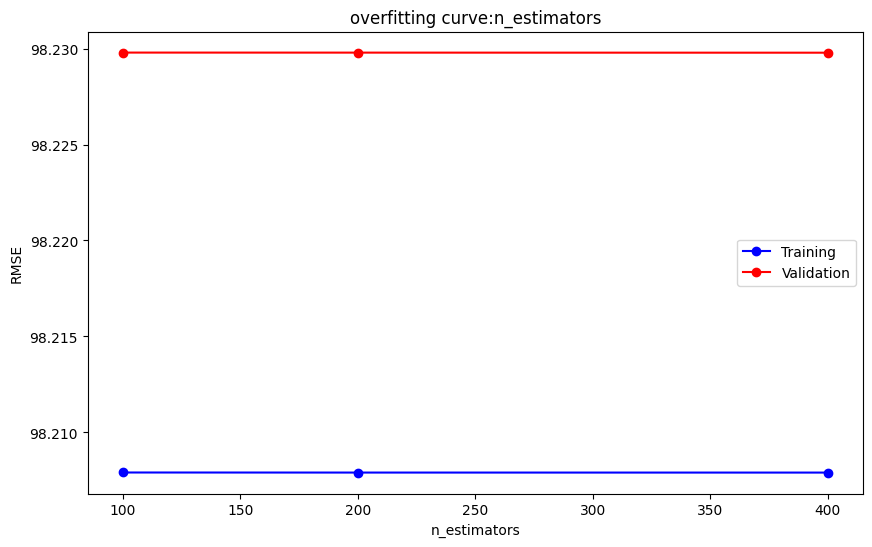

In [ ]:
%%time
test_param_and_plot(XGBRFRegressor,'n_estimators',[100,200,400],**best_params)

Changing the num_estimators is of no help !! but we can pick value ahead to predict a better model.

# Max Depth

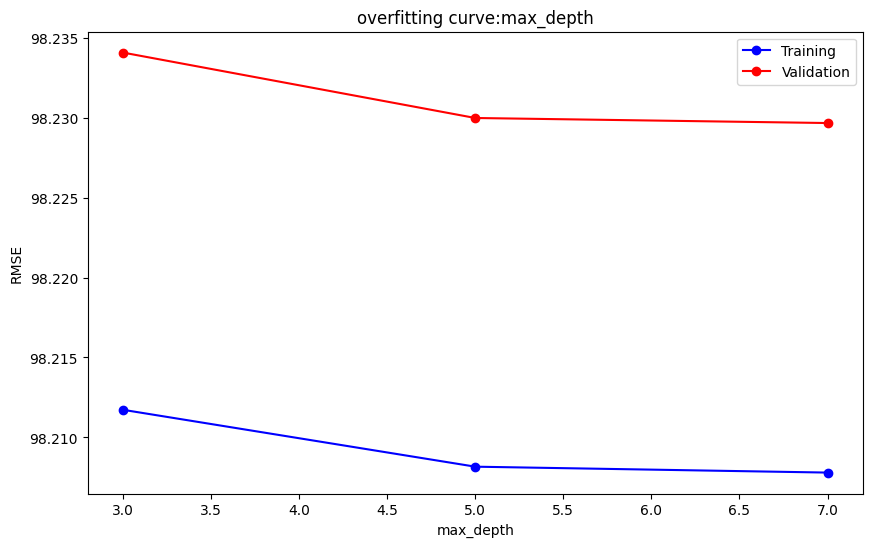

In [ ]:
test_param_and_plot(XGBRFRegressor,'max_depth',[3,5,7], **best_params)

In [ ]:
# best_param['max_depth'] = 7

# Learning Rate

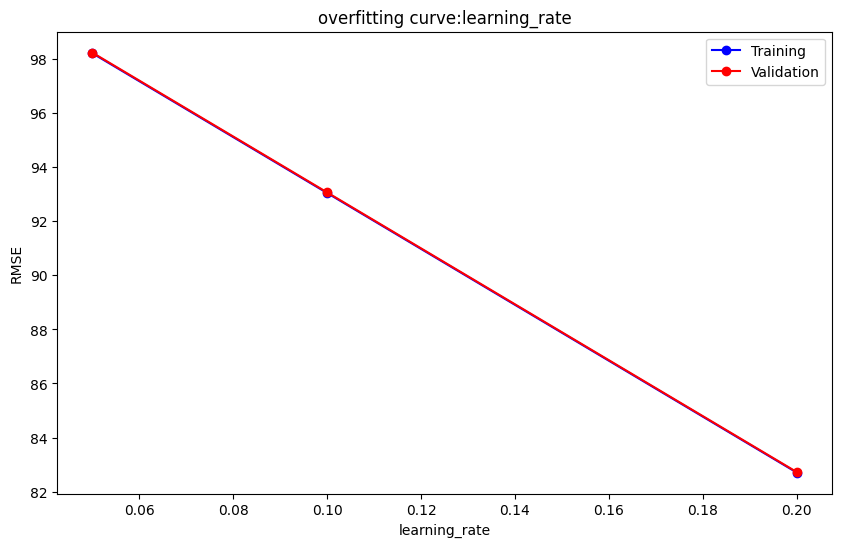

In [ ]:
test_param_and_plot(XGBRFRegressor,'learning_rate',[0.05, 0.1, 0.2], **best_params)

In [ ]:
 xgb_model_final = XGBRFRegressor(max_depth=10,objective ='reg:squarederror',n_estimators=400,random_state=42,n_jobs=-1)

In [ ]:
xgb_model_final.fit(train_inputs,train_targets)

XGBRFRegressor(base_score=None, booster=None, callbacks=None,
               colsample_bylevel=None, colsample_bytree=None,
               early_stopping_rounds=None, enable_categorical=False,
               eval_metric=None, feature_types=None, gamma=None, gpu_id=None,
               grow_policy=None, importance_type=None,
               interaction_constraints=None, max_bin=None,
               max_cat_threshold=None, max_cat_to_onehot=None,
               max_delta_step=None, max_depth=10, max_leaves=None,
               min_child_weight=None, missing=nan, monotone_constraints=None,
               n_estimators=400, n_jobs=-1, num_parallel_tree=None,
               objective='reg:squarederror', predictor=None, random_state=42,
               reg_alpha=None, ...)

In [ ]:
evaluate_rmse(xgb_model_final)


(0.7927187797871199,
 0.8037958487882277,
 array([127.42745 , 126.06193 , 125.67388 , ..., 101.02682 , 101.316216,
        101.5427  ], dtype=float32),
 array([100.04439 , 109.429474,  99.93882 , ..., 116.01368 , 109.77371 ,
        100.534096], dtype=float32))

The graident boosting model performs better after tuning hyper parameters. But we have made progress from the 60s to the 50s range which is better than 60% off the models submitted.
![](https://i.imgur.com/s8vFO82.png)

The Rmse value looks to high when evaluated with mean sqaured error as the evaluation matrix.

In [ ]:
evaluate_mae(xgb_model_final)

(0.5028184158101845,
 0.5048601710376585,
 array([127.42745 , 126.06193 , 125.67388 , ..., 101.02682 , 101.316216,
        101.5427  ], dtype=float32),
 array([100.04439 , 109.429474,  99.93882 , ..., 116.01368 , 109.77371 ,
        100.534096], dtype=float32))

But with mae there is very big difference in the values obtained pushing us much closer to the target value.

![](https://i.imgur.com/SYKZ6lX.png)

The value looks to high when evaluated with mean absolute error as the evaluation matrix. which does not make any difference as there is just value diffrence from this we can say that gradient boosting model would not be hlepfull for this particular project with rmse as the metric.
But with mae it performs the best.

In [ ]:
predict_and_submit(xgb_model_final,test_inputs,'xgb_tuned_submission.csv')

,id,trade_price
0,762679,98.197800
1,762680,116.332123
2,762681,104.333900
3,762682,106.784798
4,762683,102.317413
...,...,...
61141,823820,89.428772
61142,823821,100.244186
61143,823822,123.117622
61144,823823,85.133820


From the comparision of the 2 models RandomForest and xgboosting. ther rmse performance of random forest seems to be beter and closer compared to the other models.

But both the models perform equally good with mea. In fact gradient boosting model performs better than random forest regressor.

In [ ]:
from prettytable import PrettyTable
columns = ["Traine Mode","Rmse Score","MAE Score"]
myTable = PrettyTable()
myTable.add_column(columns[0],["Ridge Regression", " Random Forests" ,"Gradient Boosting"])
myTable.add_column(columns[1],["1.018055865146977", "0.8079385557580648" ,"1.2244134088378358"])
myTable.add_column(columns[2],["0.6145392913769832", "0.508565690116441" ,"0.8143261830163468"])
print(myTable)

+-------------------+--------------------+--------------------+
|    Traine Mode    |     Rmse Score     |     MAE Score      |
+-------------------+--------------------+--------------------+
|  Ridge Regression | 1.018055865146977  | 0.6145392913769832 |
|   Random Forests  | 0.8079385557580648 | 0.508565690116441  |
| Gradient Boosting | 1.2244134088378358 | 0.8143261830163468 |
+-------------------+--------------------+--------------------+


# Summary of the Project-


- In this project we have downloaded the datasets from Kaggle
- This is  ML Regression problem which can be sorted with
- Explored the datasets and  visualized the datasets to find the relation between the columns
- Filled missing values
- Trained Hardcoded & Baseline Mode
- Fitted various models to test best accuracies on test and validation sets
- The evaluation matrics used is RMSE and MAE.
- MAE performed better and the difference in the targets obatined had a large difference.
- Tuned hyperparameters on XGBOOST
- Made the  predictions on test dataset
- saved the predictions to the submission dataset
- exported the predictions on submission file with the respective model name
- This csv file is downloaded and could notbe  submitted to Kaggle as there is no option to submit had to do the checking manually.

In this project MAE performed better than RMSE as the evaluation metrics.


# Future works


1.   .Have to work on the model and make it better by providing more data
2.   The model can be either used to calculate the futrure price of the bonds or it can be used to provide the exact maturity date of the bond so the it can used by the clients.
3. Need to gather more data on for a integrating the projects in different ways.
4. further hyperparameter tuning has to be done to attain the required accuracy
5. Further Feature engeneering has to be done.As it was just the begining a lot can be exploered with the same data set like the prediction of the curve with each trade.


# References
- https://www.kaggle.com/competitions
- https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.plot.pie.html
- https://plotly.com/python/bar-charts/
- https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.plot.barh.html
- https://c3.ai/glossary/data-science/mean-absolute-error/
- https://c3.ai/glossary/data-science/root-mean-square-error-rmse/
- also used google to get a better understanding of the each data means has various wesites to search from!!


